In [22]:
from PIL import Image
import cv2 as cv
import os
import sys
from tqdm.notebook import tqdm
from dotenv import load_dotenv
import matplotlib.pyplot as plt
import numpy as np
from ultralytics import YOLO

import torchvision.transforms as transforms

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))
from utils.plot_wrapper import *
from utils.fix_resolutions import *

In [23]:
load_dotenv()
root = os.getenv("root", ".")

tiger_name = "K 15 M"

In [24]:
data_path = os.path.join(root, "data")
tiger_path = os.path.join(data_path, tiger_name)

images = [cv.imread(os.path.join(tiger_path, f)) for f in os.listdir(tiger_path)]
images = [cv.cvtColor(img, cv.COLOR_BGR2RGB) for img in images]
images = [Image.fromarray(img) for img in images]

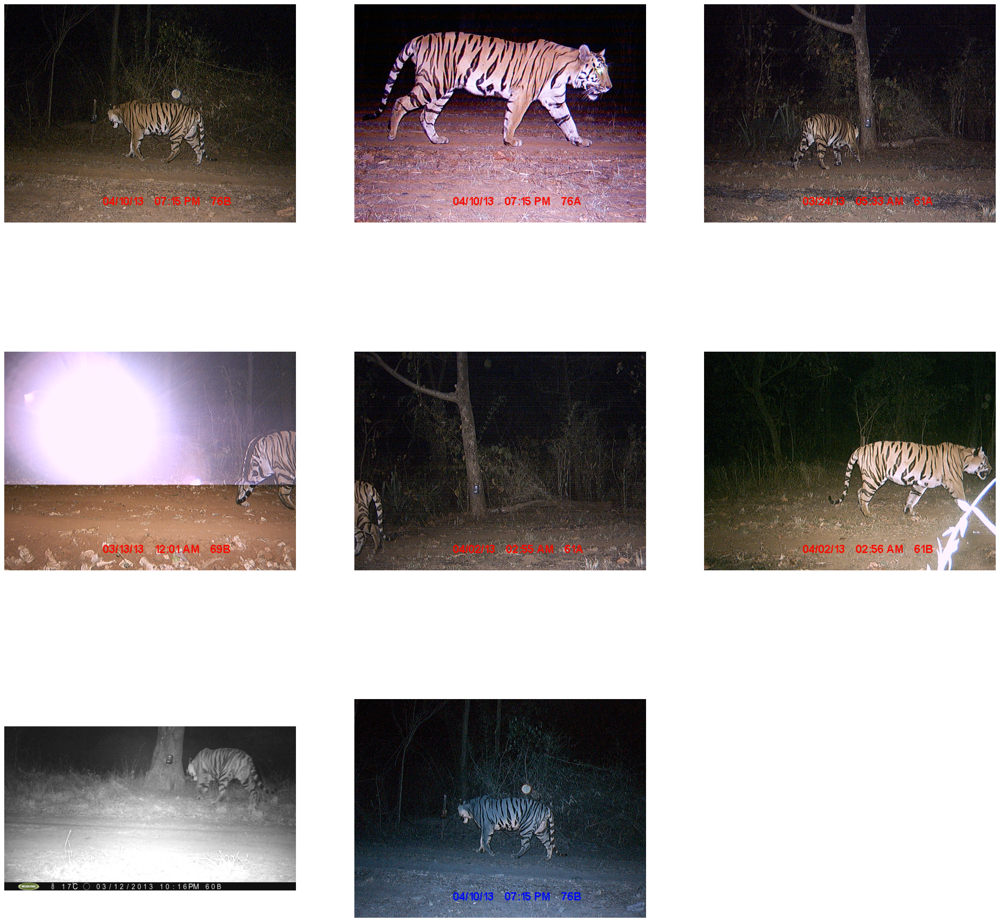

In [25]:
plot_images(images, cols=3)

In [29]:
transform = transforms.Compose([
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05)
])

In [ ]:
num_transformations = 15
transformed_images = []

for i, image in enumerate(tqdm(images, desc="Transforming images")):
    for j in range(num_transformations):
        transformed_image = transform(image)
        transformed_image = np.array(transformed_image)
        transformed_image = cv.cvtColor(transformed_image, cv.COLOR_RGB2BGR)
        transformed_images.append(transformed_image)

Transforming images:   0%|          | 0/8 [00:00<?, ?it/s]

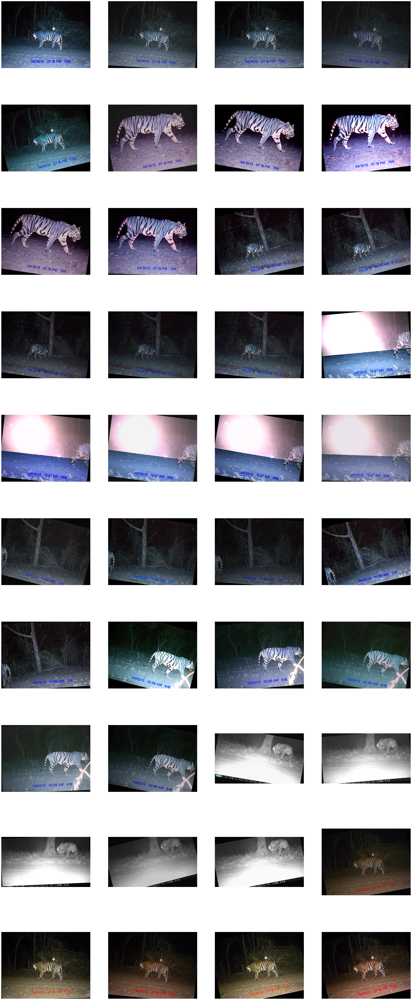

In [31]:
plot_images(transformed_images, cols=4)